In [1]:
import os
import sys
import logging
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from dredFISH.Analysis import TissueGraph
from dredFISH.Visualization import viz_cell_layer
# from dredFISH.Utils.__init__plots import *  # import one of the two; but not both
from dredFISH.Utils import powerplots

# import importlib
# importlib.reload(viz_cell_layer)

In [2]:
# plt.plot(np.arange(4))
# plt.savefig('foo.pdf')

In [3]:
logging.basicConfig(format='%(asctime)s - %(message)s', 
                datefmt='%m-%d %H:%M:%S', 
                level=logging.INFO,
                )

# Path
basepth = '/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3'

In [4]:

# load TMG - with cell layer obs only
TMG = TissueGraph.TissueMultiGraph(basepath=basepth, 
                                   redo=False, # load existing 
                                   quick_load_cell_obs=True,
                                  )

# spatial coordinates
layer = TMG.Layers[0]
XY = layer.XY
x, y = XY[:,0], XY[:,1]

#### a temporary hack
x, y = y, x 
XY = np.vstack([x,y]).T
###

/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/cell.h5ad


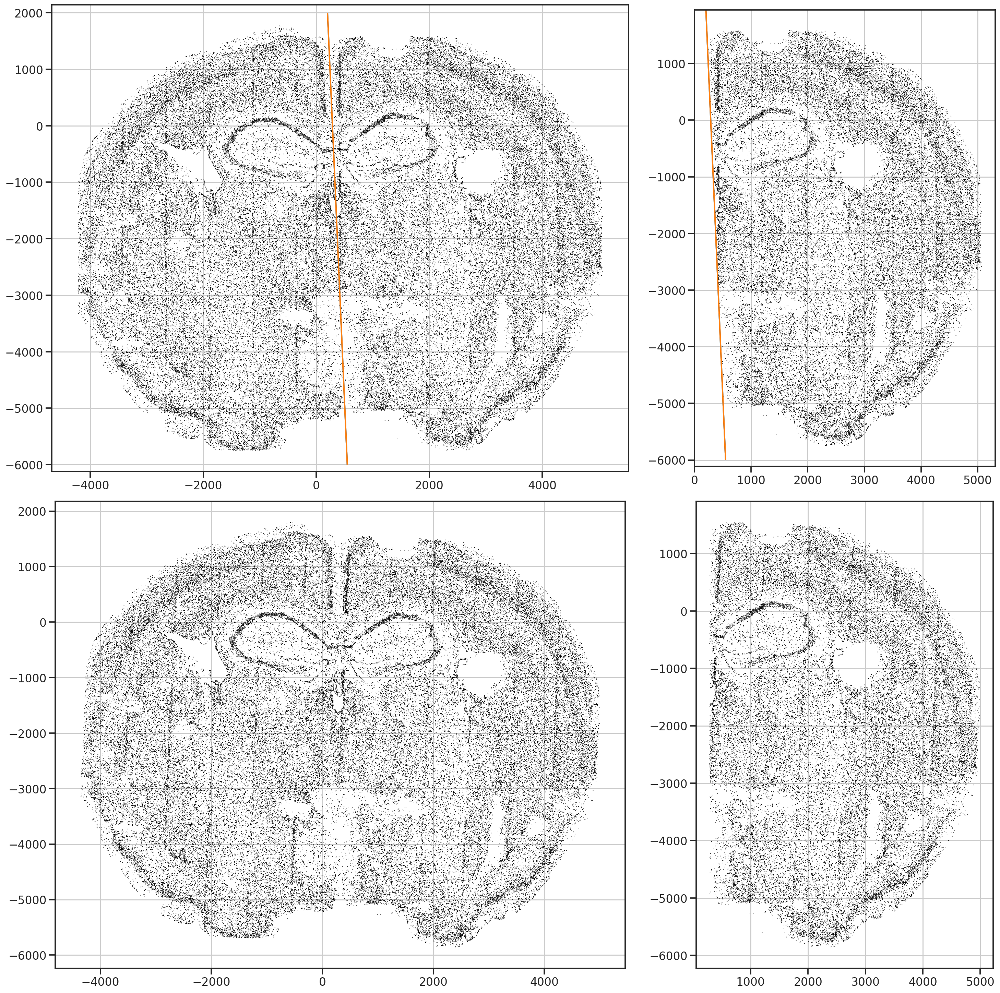

In [5]:
# define a line to split things into hemi-coronal sections
split_lines = [
    # [(0,0),(1,1)],
    [(550, -6000), (200, 2000)],
    [(200, 2000), (550, -6000)],
    # [(300, 2000), (550, -6000)],
]
cond, XYnew = viz_cell_layer.preview_hemisphere(split_lines, XY=XY)

In [6]:
%%time
df = viz_cell_layer.generate_default_analysis(split_lines, basepth, XY=XY) 
df

08-10 09:20:40 - Load TMG from /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3


/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/cell.h5ad
/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/isozone.h5ad
/bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/region.h5ad


08-10 09:21:43 - split hemisphere...
08-10 09:21:43 - generate UMAP...
08-10 09:25:01 - identify known cell types...
08-10 09:25:01 - Loading and preprocessing data
08-10 09:25:02 - 77846 cells, minimum counts = 1872.0
08-10 09:25:02 - iteration 1/3
08-10 09:25:02 - Current round: level_0
08-10 09:25:08 - iteration 2/3
08-10 09:25:08 - Current round: level_1_cluster_GABAergic
08-10 09:25:12 - Current round: level_1_cluster_Glutamatergic
08-10 09:25:15 - Current round: level_1_cluster_Non-Neuronal
08-10 09:25:15 - iteration 3/3
08-10 09:25:15 - Current round: level_2_cluster_CGE
08-10 09:25:15 - Current round: level_2_cluster_MGE
08-10 09:25:16 - Current round: level_2_cluster_Other
08-10 09:25:16 - Current round: level_2_cluster_DG/SUB/CA
08-10 09:25:16 - Current round: level_2_cluster_L2/3 IT
08-10 09:25:17 - Current round: level_2_cluster_L4/5/6 IT Car3
08-10 09:25:17 - Current round: level_2_cluster_NP/CT/L6b
08-10 09:25:18 - Current round: level_2_cluster_Other
08-10 09:25:18 - Cur

CPU times: user 13min 11s, sys: 51.8 s, total: 14min 3s
Wall time: 5min 10s


,x,y,x2,y2,hemi,b0,b1,b2,b3,b4,...,type_r0.01,type_r0.02,type_r0.05,type_r0.1,type_r0.2,type_r0.5,type_r1,type_r2,type_r5,type_r10
0,1911.666962,-1749.638192,1833.366541,-1831.521636,1,-0.603849,1.714861,0.594060,0.139496,1.509942,...,t1,t1,t1,t3,t2,t5,t7,t3,t50,t37
1,1850.678429,-1747.172043,1772.544083,-1826.392145,1,-0.530279,1.681959,1.301185,-0.464006,1.570054,...,t1,t1,t1,t3,t2,t5,t7,t3,t50,t37
2,1515.123295,-1746.940031,1437.319766,-1811.493848,1,-0.603849,-0.362498,0.620053,-1.128423,1.206578,...,t1,t1,t1,t3,t2,t10,t10,t6,t44,t38
3,1426.161788,-1748.456394,1348.376999,-1809.120415,1,-0.298989,1.023065,1.517082,-0.341796,0.475449,...,t1,t1,t1,t3,t2,t10,t10,t6,t47,t110
4,1739.792930,-1749.407386,1661.666850,-1823.778747,1,-0.603849,-1.351786,1.025515,-1.128423,0.327118,...,t1,t1,t1,t1,t1,t1,t2,t5,t16,t10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77841,-2188.756848,-1084.480934,-2234.065840,-987.777939,0,-0.603849,-0.271399,-0.666686,0.269214,0.821624,...,t1,t1,t1,t4,t5,t8,t12,t20,t57,t71
77842,-2257.822983,-1083.270665,-2303.013073,-983.550072,0,0.936062,0.386319,-0.614982,1.752306,0.067531,...,t1,t1,t3,t4,t5,t8,t12,t8,t2,t42
77843,-2475.320577,-1083.995803,-2520.334508,-974.768090,0,-0.603849,-0.228163,-0.612215,0.895132,0.247026,...,t1,t1,t2,t2,t4,t6,t8,t23,t43,t70
77844,-2311.578984,-1086.717336,-2356.868349,-984.643871,0,-0.603849,-1.153599,0.699586,-0.204732,1.546018,...,t1,t1,t1,t1,t1,t1,t3,t16,t49,t114


# Viz

In [7]:
dfpth = os.path.join(basepth, 'default_analysis.csv')
df = pd.read_csv(dfpth, index_col=0)
df

,x,y,x2,y2,hemi,b0,b1,b2,b3,b4,...,type_r0.01,type_r0.02,type_r0.05,type_r0.1,type_r0.2,type_r0.5,type_r1,type_r2,type_r5,type_r10
0,1911.666962,-1749.638192,1833.366541,-1831.521636,1,-0.603849,1.714861,0.594060,0.139496,1.509942,...,t1,t1,t1,t3,t2,t5,t7,t3,t50,t37
1,1850.678429,-1747.172043,1772.544083,-1826.392145,1,-0.530279,1.681959,1.301185,-0.464006,1.570054,...,t1,t1,t1,t3,t2,t5,t7,t3,t50,t37
2,1515.123295,-1746.940031,1437.319766,-1811.493848,1,-0.603849,-0.362498,0.620053,-1.128423,1.206578,...,t1,t1,t1,t3,t2,t10,t10,t6,t44,t38
3,1426.161788,-1748.456394,1348.376999,-1809.120415,1,-0.298989,1.023065,1.517082,-0.341796,0.475449,...,t1,t1,t1,t3,t2,t10,t10,t6,t47,t110
4,1739.792930,-1749.407386,1661.666850,-1823.778747,1,-0.603849,-1.351786,1.025515,-1.128423,0.327118,...,t1,t1,t1,t1,t1,t1,t2,t5,t16,t10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77841,-2188.756848,-1084.480934,-2234.065840,-987.777939,0,-0.603849,-0.271399,-0.666686,0.269214,0.821624,...,t1,t1,t1,t4,t5,t8,t12,t20,t57,t71
77842,-2257.822983,-1083.270665,-2303.013073,-983.550072,0,0.936062,0.386319,-0.614982,1.752306,0.067531,...,t1,t1,t3,t4,t5,t8,t12,t8,t2,t42
77843,-2475.320577,-1083.995803,-2520.334508,-974.768090,0,-0.603849,-0.228163,-0.612215,0.895132,0.247026,...,t1,t1,t2,t2,t4,t6,t8,t23,t43,t70
77844,-2311.578984,-1086.717336,-2356.868349,-984.643871,0,-0.603849,-1.153599,0.699586,-0.204732,1.546018,...,t1,t1,t1,t1,t1,t1,t3,t16,t49,t114


In [8]:
respth = os.path.join(basepth, 'figures')
if not os.path.isdir(respth):
    os.mkdir(respth)

08-10 09:25:51 - Num pixels: (464, 375)
08-10 09:26:05 - saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig1_basis_space.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig1_basis_space_2022-08-10.pdf


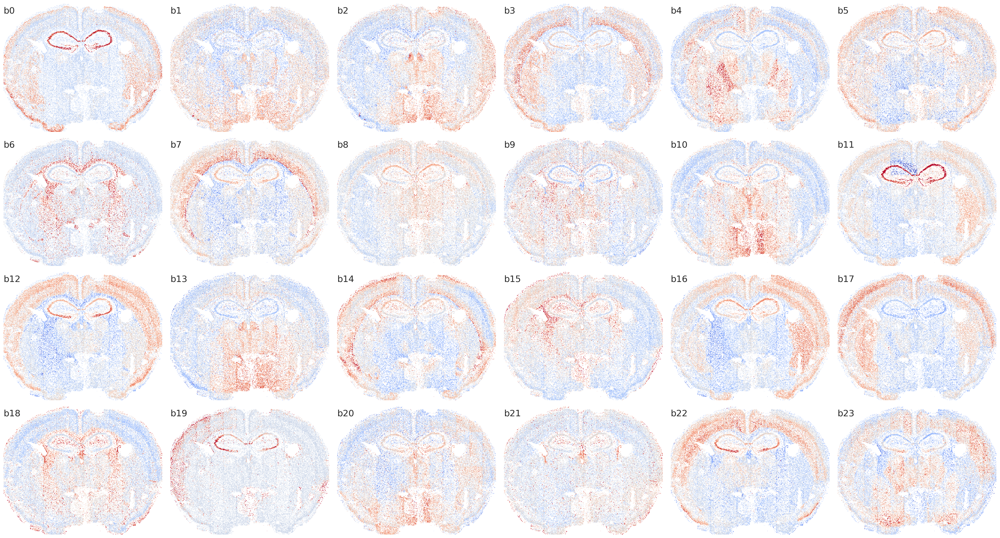

CPU times: user 16.7 s, sys: 491 ms, total: 17.2 s
Wall time: 17.2 s


In [9]:
%%time
output = os.path.join(respth, 'fig1_basis_space.pdf')
# output = None
powerplots.plot_basis_spatial(df, output=output)


08-10 09:28:37 - Num pixels: (235, 369)
08-10 09:28:58 - saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig1-2_basis_space_righthalf.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig1-2_basis_space_righthalf_2022-08-10.pdf


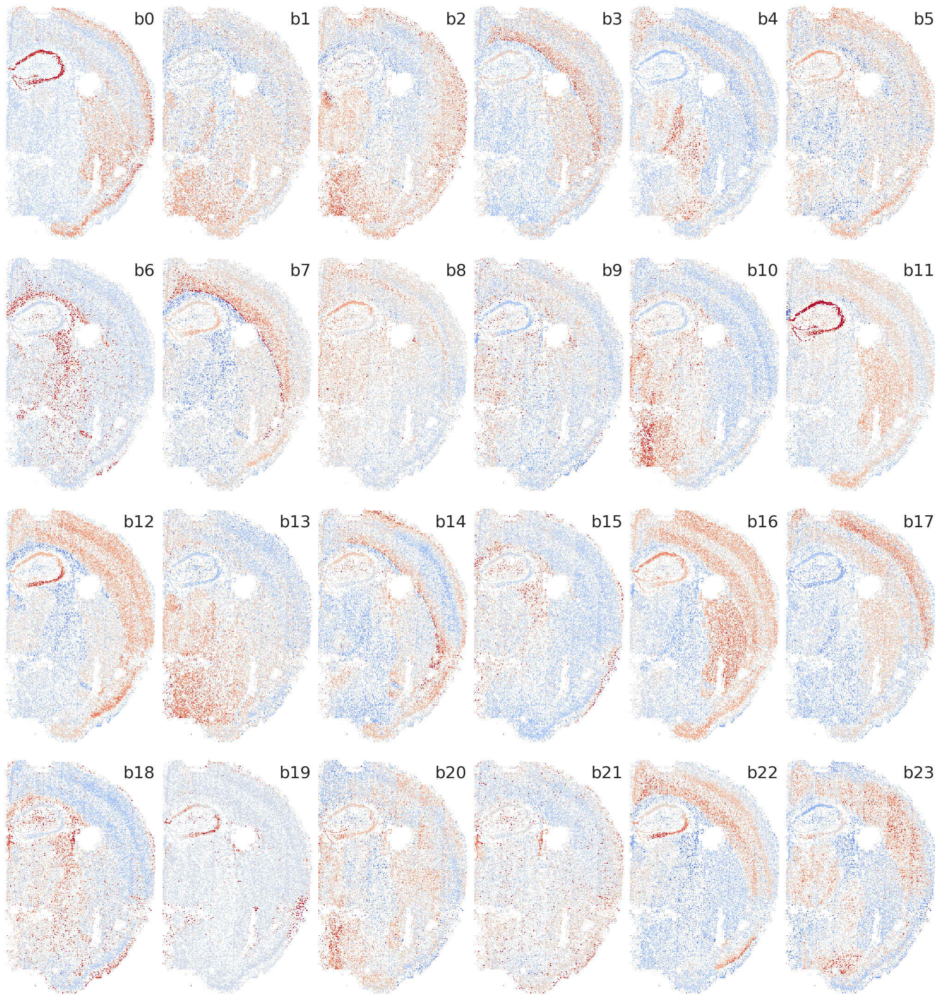

CPU times: user 22.4 s, sys: 327 ms, total: 22.7 s
Wall time: 22.7 s


In [12]:
%%time
dfsub = df[df['hemi']==1]
output = os.path.join(respth, 'fig1-2_basis_space_righthalf.pdf')
# output = None
powerplots.plot_basis_spatial(dfsub, pmode='right_half', xcol='x2', ycol='y2', output=output)

INFO:root:Num pixels: (300, 256)
INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig2_basis_umap.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig2_basis_umap_2022-07-19.pdf


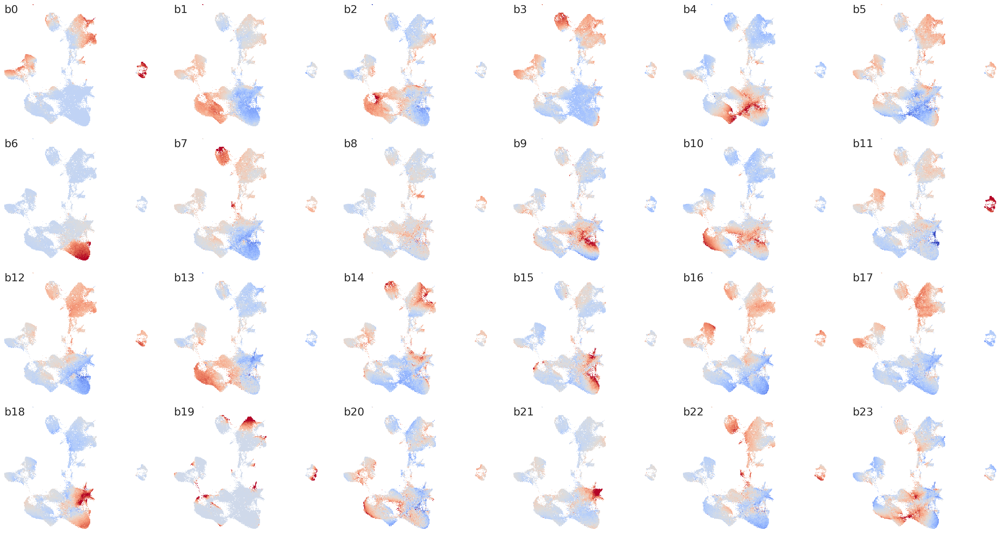

CPU times: user 13.9 s, sys: 319 ms, total: 14.2 s
Wall time: 14.2 s


In [11]:
%%time
output = os.path.join(respth, 'fig2_basis_umap.pdf')
# output = None
powerplots.plot_basis_umap(df, output=output)

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-0_type_r0.01.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-0_type_r0.01_2022-07-19.pdf


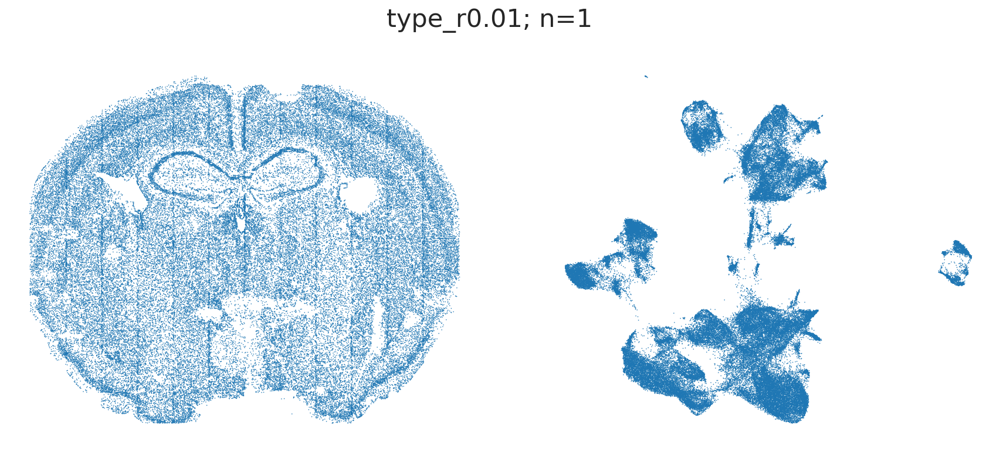

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-1_type_r0.02.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-1_type_r0.02_2022-07-19.pdf


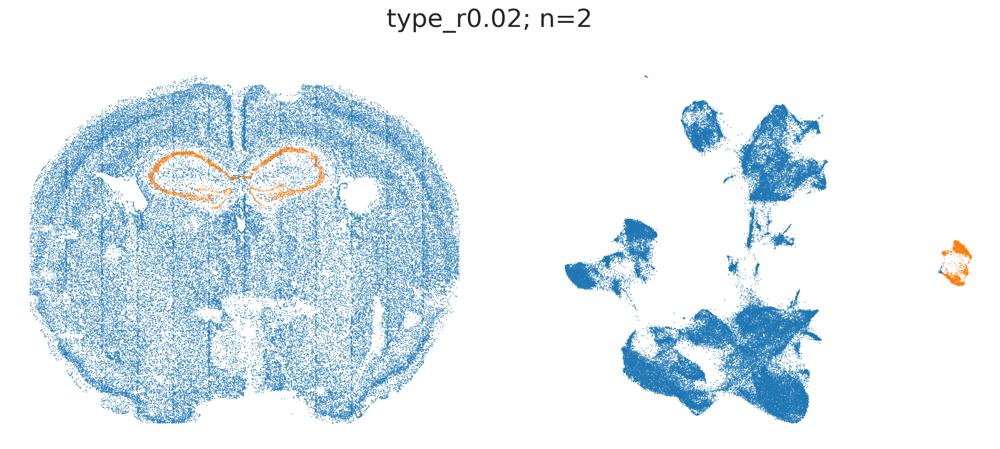

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-2_type_r0.05.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-2_type_r0.05_2022-07-19.pdf


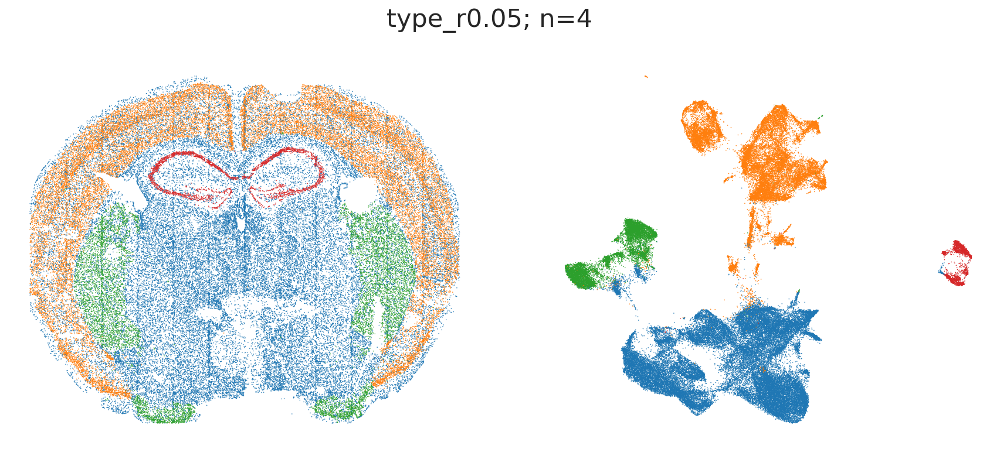

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-3_type_r0.1.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-3_type_r0.1_2022-07-19.pdf


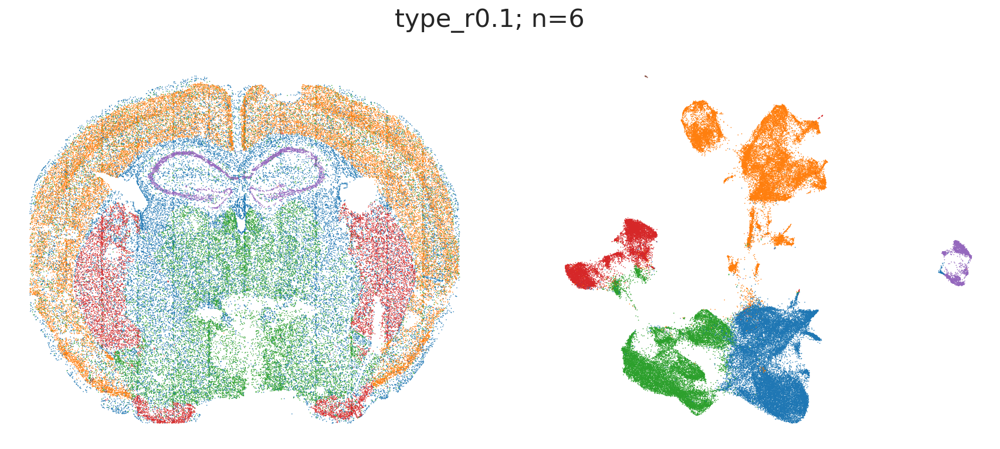

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-4_type_r0.2.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-4_type_r0.2_2022-07-19.pdf


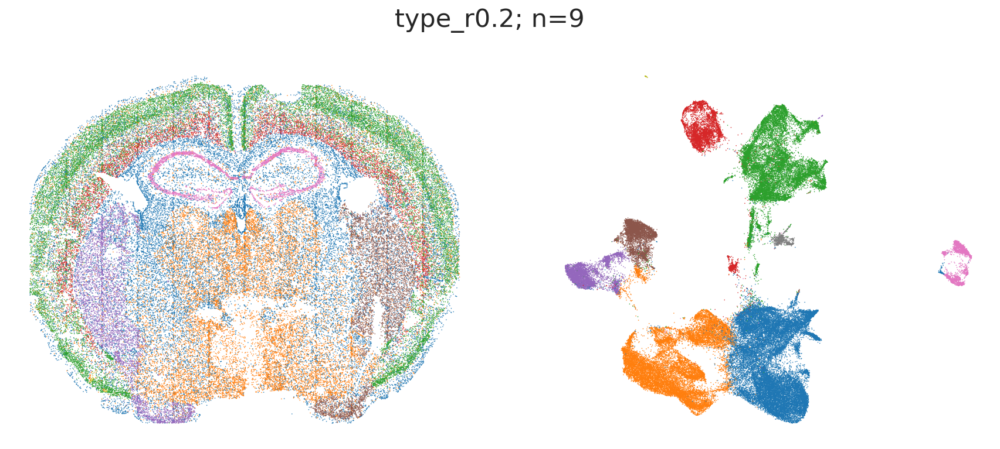

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-5_type_r0.5.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-5_type_r0.5_2022-07-19.pdf


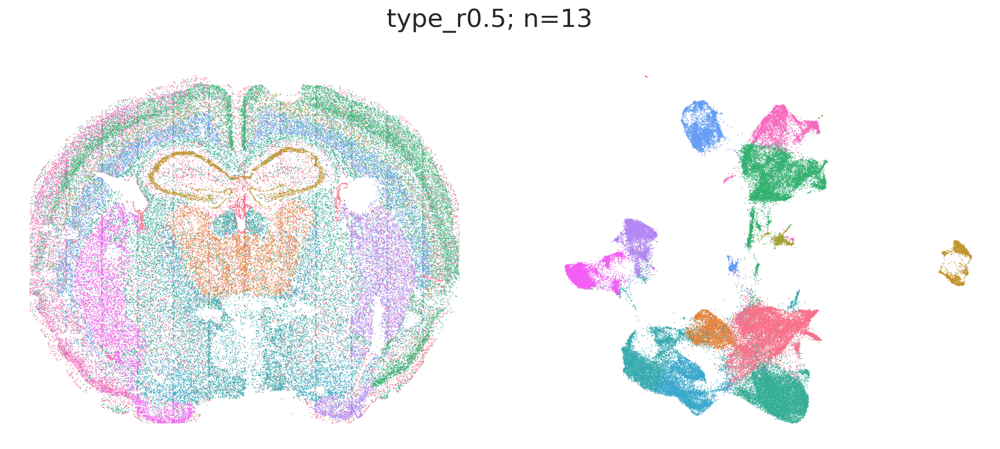

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-6_type_r1.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-6_type_r1_2022-07-19.pdf


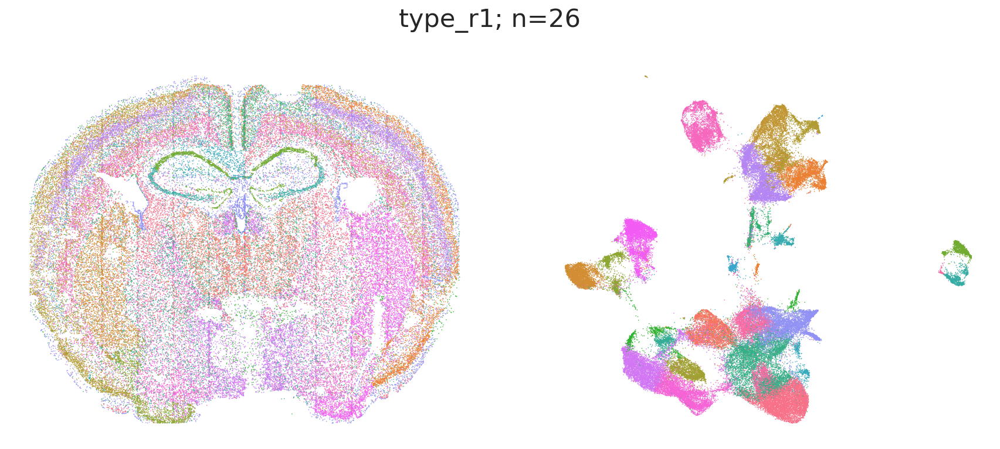

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-7_type_r2.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-7_type_r2_2022-07-19.pdf


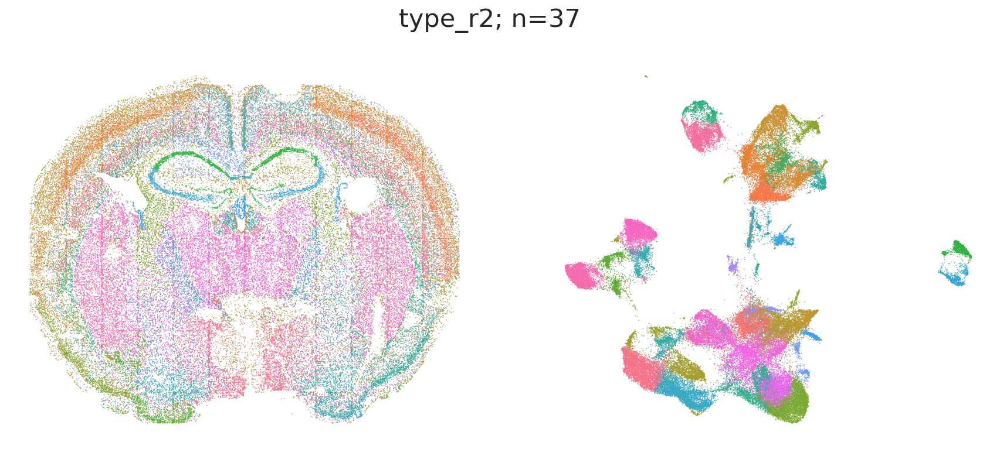

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-8_type_r5.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-8_type_r5_2022-07-19.pdf


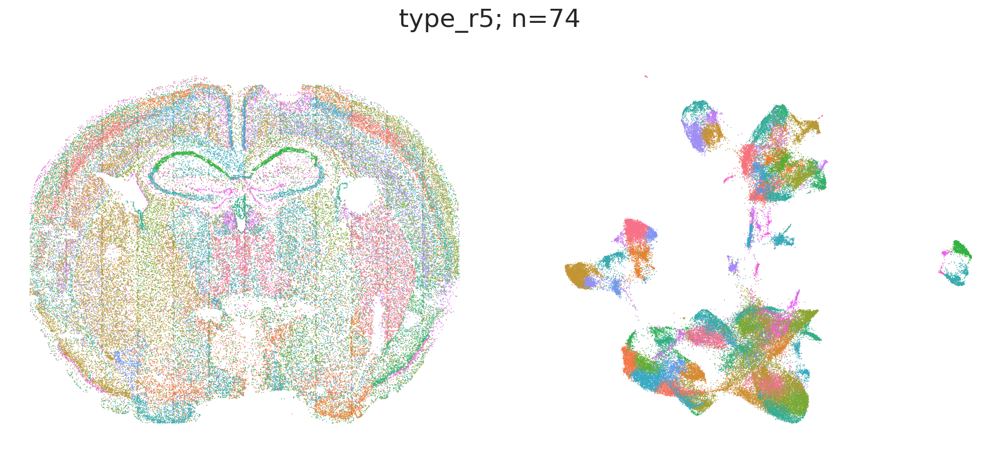

INFO:root:saved: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-9_type_r10.pdf


saved the figure to: /bigstore/GeneralStorage/Data/dredFISH/Dataset1-t3/figures/fig3-9_type_r10_2022-07-19.pdf


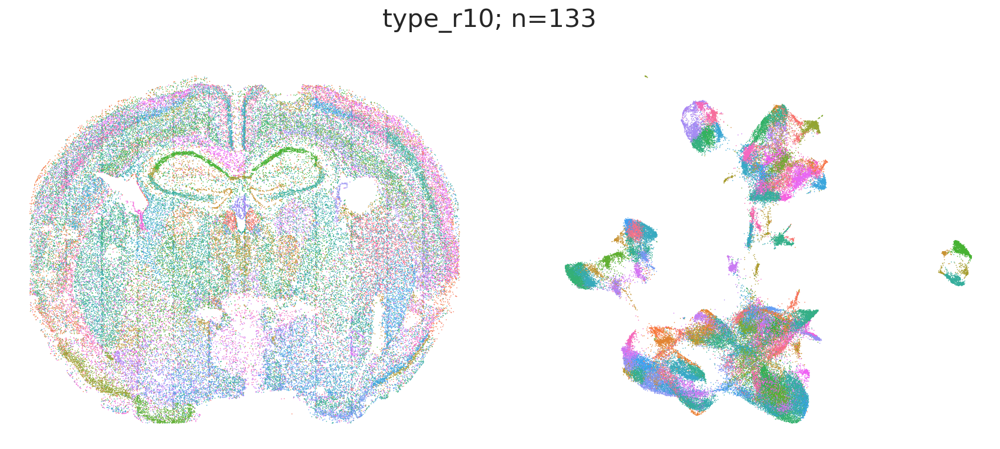

CPU times: user 4min 18s, sys: 2.37 s, total: 4min 20s
Wall time: 4min 17s


In [12]:
%%time
# # resolutions = np.sort([ for col in typecols])
#     r = float(col[len("type_r"):])

typecols = df.filter(regex='^type_r', axis=1).columns
for i, col in enumerate(typecols):
    hue = col
    output = os.path.join(respth, f'fig3-{i}_{col}.pdf')
    # output = None
    powerplots.plot_type_spatial_umap(df, hue, output=output)